In [0]:
a = []
while(1):
    a.append('1')

In [0]:
%tensorflow_version 1.x
import numpy as np
import matplotlib.pyplot as plt
from hw3_utils import *
#from hw3_attribution import *
# import tensorflow.compat.v1 as tf
# tf.disable_v2_behavior()

TensorFlow is already loaded. Please restart the runtime to change versions.


In [0]:
class SaliencyMap(object):
    """Implementaion of Saliency Map with Vanilla Gradient

        https://arxiv.org/pdf/1312.6034.pdf

        Example Usage:
        ## >>> attr_fn = SaliencyMap(sess, input_tensor, output_tensor, 0)
        ## >>> saliency_map = attr_fn(X) <--- equivalent to attr_fn.__call__(X)
    """
    def __init__(self, sess, input_tensor, output_tensor, target_class):
        """__Constructor__

        Arguments:
            sess {tf.Session} -- Tensorflow session
            input_tensor {tf.Tensor} -- Symbolic tensor of input node
            output_tensor {tf.Tensor} -- Symbolic tensor of pre-softmax output
            target_class {int} -- The class of interest to run explanation.
        """
        self.sess = sess
        self.input_tensor = input_tensor
        self.output_tensor = output_tensor
        self.target_class = target_class

        self._define_ops()

    def _define_ops(self):
        """Add whatever operations you feel necessary into the computational
        graph.
        """

        # >>> Your code starts here <<<
        y_s = self.output_tensor[:, self.target_class]
        x_s = self.input_tensor
        self.gradients = tf.gradients(ys=y_s, xs=x_s)[0]
        self.multiplied_gradients = tf.multiply(self.input_tensor, self.gradients)
        # >>> Your code ends here <<<

    def __call__(self, X, batch_size=16, multiply_with_input=True):
        """__call__ forward computation to generate the saliency map

        Arguments:
            X {np.ndarray} -- Input dataset

        Keyword Arguments:
            batch_size {int} -- Batch size (default: {16})
            multiply_with_input {bool} -- If True, return grad x input,
                else return grad (default: {True})

        Returns np.ndarray of the same shape as X.
        """
        # >>> Your code starts here <<<
        gradients, multiplied_gradients = self.sess.run([self.gradients, self.multiplied_gradients], feed_dict={self.input_tensor: X})   
        print(gradients.shape)
        if multiply_with_input:
            return multiplied_gradients
        else:
            return gradients

In [0]:
img = img_to_array(load_img("laska.png", target_size=(224, 224)))
images = ['laska.png', 'camel.png']
imgs = np.zeros((2, 224, 224, 3))
imgs = np.array([img_to_array(load_img(i, target_size=(224, 224))) for i in images])
label = ImageNet_name2idx("weasel")
with tf.Session() as session:
    model = get_model(session)
    salience = SaliencyMap(session, model.imgs, model.fc3l, label)
    saliency_map = salience(imgs, 16, True)

KeyboardInterrupt: ignored

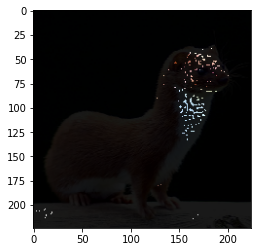

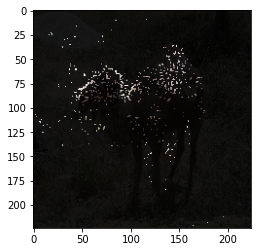

In [0]:
for index, img in enumerate(imgs):
    map = binary_mask(img.reshape(1, 224, 224, 3), saliency_map[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
class IntegratedGrad(object):
    """Implementaion of Integrated Gradient
        https://arxiv.org/pdf/1703.01365.pdf
        Example Usage:
        >>> attr_fn = IntegratedGrad(sess, input_tensor, output_tensor, 0)
        >>> integrated_grad = attr_fn(X, 'black')
    """
    def __init__(self, sess, input_tensor, output_tensor, target_class):
        """_Constructor_
        Arguments:
            sess {tf.Session} -- Tensorflow session
            input_tensor {tf.Tensor} -- Symbolic tensor of input node
            output_tensor {tf.Tensor} -- Symbolic tensor of pre-softmax output
            target_class {int} -- The class of interest to run explanation.
        """
        np.random.seed(1111)
        self.sess = sess
        self.input_tensor = input_tensor
        self.output_tensor = output_tensor
        self.target_class = target_class
        self._define_ops()

    def _define_ops(self):
        """Add whatever operations you feel necessary into the computational
        graph.
        """
        # >>> Your code starts here <<<
        self.x_baseline = tf.placeholder(tf.float32, shape=self.input_tensor.get_shape()[1:])
        self.alpha = tf.placeholder(tf.float32, shape=())
        self.step = self.x_baseline + (self.input_tensor - self.x_baseline) * self.alpha
        self.gradient = tf.gradients(self.output_tensor[:, self.target_class], self.input_tensor)[0]
        self.multiplied_gradient = tf.multiply(self.gradient, self.input_tensor - self.x_baseline)
        # >>> Your code ends here <<<
    def __call__(self,
                 X,
                 baseline='black',
                 batch_size=16,
                 num_steps=50,
                 multiply_with_input=True):
        """_call_ forward computation to generate the integrated gradient
        Arguments:
            X {np.array} -- Input dataset
        Keyword Arguments:
            baseline {str} -- The baseline input. One of 'black', 'white',
                or 'random' (default: {'black'})
            batch_size {int} -- Batch size (default: {16})
            num_steps {int} -- resolution of using sum to approximate the
                integral (default: {50})
            multiply_with_input {bool} -- If True, return grad x input,
                else return grad (default: {True})
        Returns np.ndarray of the same shape as X.
        """
        # >>> Your code starts here <<<
        if baseline == 'black':
            x_baseline = np.zeros(shape=(self.input_tensor.get_shape()[1:]))
        elif baseline == 'white':
            x_baseline = np.ones(shape=(self.input_tensor.get_shape()[1:]))
        elif baseline == 'random':
            x_baseline = np.random.normal(0, 0.1, self.input_tensor.get_shape()[1:])
        
        total_gradient = None
        for i in range(num_steps):
            alpha = (i+1)/num_steps
            #print('step', step_mult)
            x_step = self.sess.run(self.step, {self.x_baseline: x_baseline, self.alpha: alpha, self.input_tensor: X})
            gradient = self.sess.run(self.gradient, {self.input_tensor: x_step})
            if total_gradient is None:
                total_gradient = gradient
            else:
                total_gradient += gradient

        if multiply_with_input:
            return  (X - x_baseline) * total_gradient/num_steps
        else:
            return total_gradient/num_steps


In [0]:
img2 = img_to_array(load_img("laska.png", target_size=(224, 224)))
images2 = ['laska.png', 'camel.png']
imgs2 = np.zeros((2, 224, 224, 3))
imgs2 = np.array([img_to_array(load_img(i, target_size=(224, 224))) for i in images2])
label = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
with tf.Session() as session:
    model = get_model(session)
    IG = IntegratedGrad(session, model.imgs, model.fc3l, label)
    IG_map = IG(imgs2,'black', 16, 50, True)

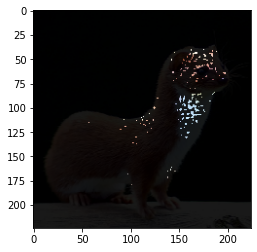

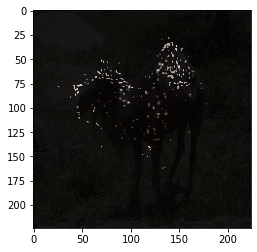

In [0]:
for index, img in enumerate(imgs2):
    map = binary_mask(img.reshape(1, 224, 224, 3), IG_map[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
class InflDirected(object):
    """Implementaion of Influence Directed Explanation

        https://arxiv.org/abs/1802.03788
    """
    def __init__(self, sess,
                 input_tensor, internal_layer,
                 output_tensor, qoi):
        """__Constructor__

        Arguments:
            sess {tf.Session} -- Tensorflow session
            input_tensor {tf.Tensor} -- Symbolic tensor of (batch of) inputs
            internal_layer {tf.Tensor} -- Symbolic tensor of internal layer
              output
            output_tensor {tf.Tensor} -- Symbolic tensor of (batch of)
              pre-softmax outputs
            qoi {tf.Tensor -> tf.Tensor} -- The quantity of interest, a
              function that takes in a single instance output and produces
              the quantity of interest tensor for that output.

            Example usage of qoi:
              InflDirected(sess, input_batch, layer,
                           output_batch, qoi=lambda out: out[target_class])
            # for some target class target_class

        """
        self.sess = sess
        self.input_tensor = input_tensor
        self.internal_layer = internal_layer
        self.output_tensor = output_tensor

        self.qoi = tf.map_fn(qoi, self.output_tensor)

        self._define_ops()

    def _define_ops(self):
        """Add whatever operations you feel necessary into the computational
        graph. Feel free to add more helper functions in you feel this one is
        not enough for your implementation
        """

        # >>> Your code starts here <<<
        y_s = self.qoi
        x_s = self.internal_layer
        self.gradients = tf.gradients(ys=y_s, xs=x_s)
        # >>> Your code ends here <<<

    def dis_influence(self, X, batch_size=16):
        """Compute the distribution of influence and return the expert neuron

        Arguments:
            X {np.ndarray} -- Input dataset

        Keyword Arguments:
            batch_size {int} -- Batch Size (default: {16})

        Returns:
            int -- The expert neuron in the internal layer.
        """
        expert_id = None
        # >>> Your code starts here <<<

        num_images = X.shape[0]
        gradients = self.sess.run(self.gradients, feed_dict={self.input_tensor: X})
        gradients = np.sum(gradients, axis=1) / num_images
        expert_id = np.argmax(gradients)
        # >>> Your code ends here <<<
        return expert_id

        # expert_id = None
        # # >>> Your code starts here <<<
        # N = X.shape[0]
        # grads = 0
        # Loop over batches
        # for batch in range(N):
        #     x_batch = np.expand_dims(X[batch], axis = 0)
        #     # Fetch the gradients
        #     gradients = self.sess.run([self.gradients], feed_dict={self.input_tensor: x_batch})
        #     grads += np.asmatrix(np.asarray(gradients))
        # # Divide gradient aggregate by size of batch
        # grads = grads / N
        # # Argmax returns the Expert Id
        # expert_id = np.argmax(grads)
        # # >>> Your code ends here <<<
        # return expert_id

    def expert_attribution(self,
                           expert_id,
                           X,
                           batch_size=16,
                           multiply_with_input=True):
        """__call__ forward computation to generate the saliency map

        Arguments:
            expert_id {int} -- The nueron index of expert
            X {np.ndarray} -- Input dataset

        Keyword Arguments:
            batch_size {int} -- Batch size (default: {16})
            multiply_with_input {bool} -- If True, return grad x input,
                else return grad (default: {True})

        Returns np.ndarray of the same shape as X.
        """
        # #>>> Your code starts here <<<
        y_s = self.internal_layer[:, expert_id]
        x_s = self.input_tensor
        self.saliency_grads = tf.gradients(ys=y_s, xs=x_s)[0]
        self.saliency_output_grads = tf.multiply(self.input_tensor, self.saliency_grads)
        gradients, multiplied_gradients = self.sess.run([self.saliency_grads, self.saliency_output_grads], feed_dict={self.input_tensor: X})
        if multiply_with_input:
            return multiplied_gradients
        else:
            return gradients

In [0]:
img3 = img_to_array(load_img("laska.png", target_size=(224, 224)))
images = ['laska.png', 'camel.png']
imgs = np.array([img_to_array(load_img(i, target_size=(224,224))) for i in images])
# print(images[0].shape)
# print(image_set[0][0].shape)
imgs = np.array([image_set[0][i] for i in range(25)])
label = ImageNet_name2idx("weasel")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    expert_unit = InfluenceD.dis_influence(imgs, 16)
    print(expert_unit)
    attr_map = InfluenceD.expert_attribution(expert_unit, imgs, True)

(1, 4096)
1982


In [0]:
print(imgs[0])
print(image_set[0][0])

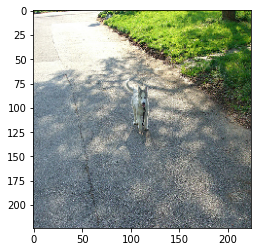

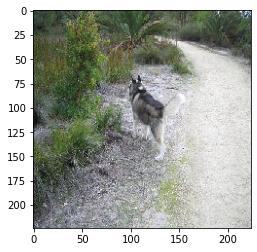

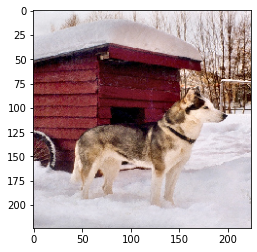

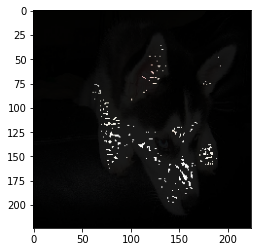

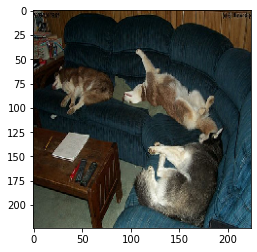

...

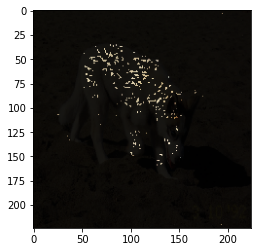

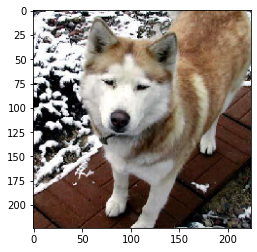

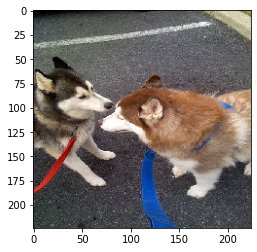

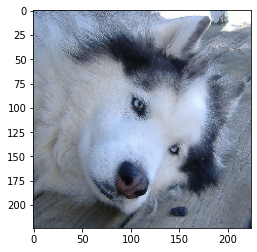

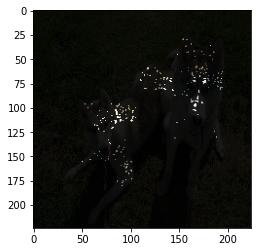

In [0]:
for idx, img in enumerate(imgs):
    map = binary_mask(imgs[idx].reshape(1, 224, 224, 3), attr_map[idx].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
print(attr_map.shape)

(1, 224, 224, 3)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


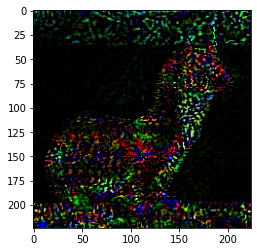

In [0]:
point_cloud_laska = point_cloud(attr_map.reshape(224, 224, 3))
plt.imshow(point_cloud_laska.reshape(224, 224, 3))
plt.show()
#print(point_cloud_laska)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


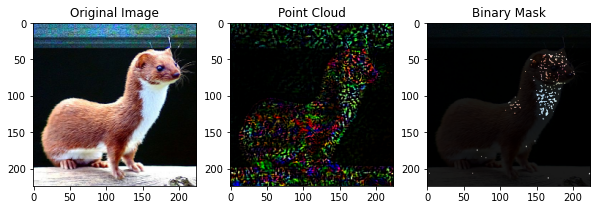

In [0]:
laska_list = [laska, point_cloud_laska, map.reshape(224, 224, 3)]
fig, axs = plt.subplots(1, 3, figsize=(10, 3))
for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], laska_list):
    ax.imshow(img)
    ax.set_title(title)
    #ax.grid(True)
plt.show()
#plt.savefig('')

In [0]:
for index, img in enumerate(imgs3):
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map.reshape(1, 224, 224, 3))
    #print(attr_map.shape)
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


In [0]:
cd drive/My\ Drive/

[Errno 2] No such file or directory: 'drive/My Drive/'
/content/drive/My Drive/SFDL_HW_3


In [0]:
cd SFDL_HW_3/

[Errno 2] No such file or directory: 'SFDL_HW_3/'
/content/drive/My Drive/SFDL_HW_3


In [0]:
image_set = load_ImageNet()

Written Exercise 11: Report the indices of the expert neuron at fc_1 layer w.r.t. the camel and weasel classes, (A) when the distribution of interest is the entire dataset.
 

In [0]:
weasel_idx_list = []
camel_idx_list = []
for idx, label in enumerate(image_set[1]):
    if label == 356:
        weasel_idx_list.append(idx)
    if label == 354:
        camel_idx_list.append(idx)
print(weasel_idx_list)
weasel_images = np.zeros((len(weasel_idx_list), 224, 224, 3))
weasel_images = np.asarray([image_set[0][idx] for idx in weasel_idx_list])
camel_images = np.zeros((len(camel_idx_list), 224, 224, 3))
camel_images = np.asarray([image_set[0][idx] for idx in camel_idx_list])
print(weasel_images.shape)
print(camel_images.shape)
all_images = np.zeros((len(image_set[0]), 224, 224, 3))
all_images = np.asarray([image_set[0][idx] for idx in range(len(image_set[0]))])

[800, 801, 802, 803, 804, 805, 806, 807, 808, 809, 810, 811, 812, 813, 814, 815, 816, 817, 818, 819, 820, 821, 822, 823, 824, 825, 826, 827, 828, 829, 830, 831, 832, 833, 834, 835, 836, 837, 838, 839, 840, 841, 842, 843, 844, 845, 846, 847, 848, 849, 850, 851, 852, 853, 854, 855, 856, 857, 858, 859, 860, 861, 862, 863, 864, 865, 866, 867, 868, 869, 870, 871, 872, 873, 874, 875, 876, 877, 878, 879, 880, 881, 882, 883, 884, 885, 886, 887, 888, 889, 890, 891, 892, 893, 894, 895, 896, 897, 898, 899]
(100, 224, 224, 3)
(100, 224, 224, 3)


In [0]:
camel = img_to_array(load_img("camel.png", target_size=(224, 224)))
laska = img_to_array(load_img("laska.png", target_size=(224, 224)))

In [0]:
label = ImageNet_name2idx("weasel")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    #expert_unit_all = InfluenceD.dis_influence(image_set[0], 1)
    #print('Expert Neuron for all images: ', expert_unit_all)
    #attr_map_all = InfluenceD.expert_attribution(expert_unit_all, all_images)
    expert_unit_weasel_only = InfluenceD.dis_influence(weasel_images, 1)
    print('Expert Neuron for weasel images: ', expert_unit_weasel_only)
    attr_map_weasel_only = InfluenceD.expert_attribution(expert_unit_weasel_only, weasel_images)

(100, 4096)
Expert Neuron for weasel images:  1426


In [0]:
idx_start = 800
idx_finish = 900
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_all[index + idx_start].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

800


NameError: ignored

Visualization Creation for Weasel with distribution of influence being all images.

In [0]:
idx_for_img = [18, 384, 887]
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_all[i])
    #plt.imshow(point_cloud.reshape(224, 224, 3))
    #plt.show()
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_all[i].reshape(1, 224, 224, 3))
    #plt.imshow(map.reshape(224, 224, 3))
    #plt.show()
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Weasel_Target_Whole_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

800


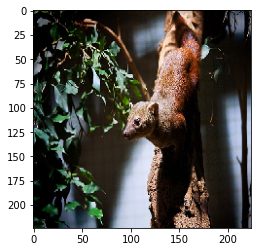

801


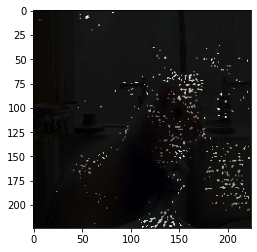

802


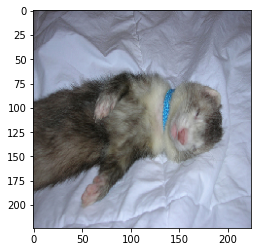

803


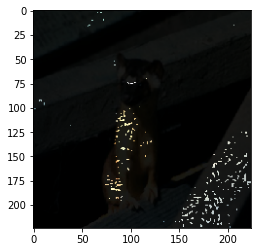

804


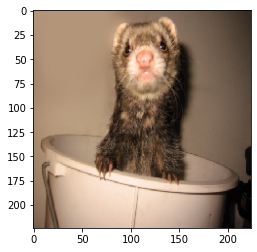

805


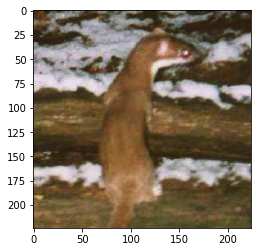

806


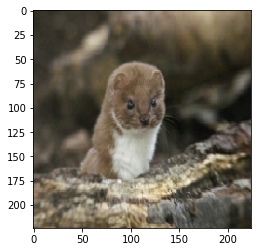

807


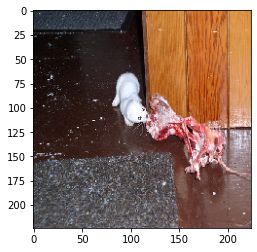

808


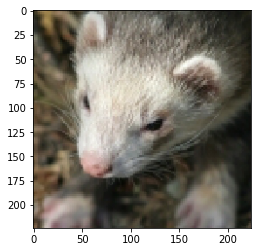

809


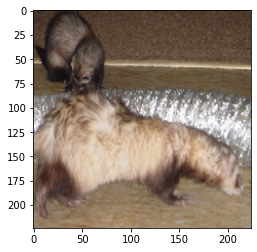

810


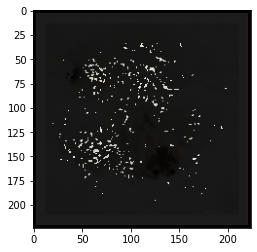

811


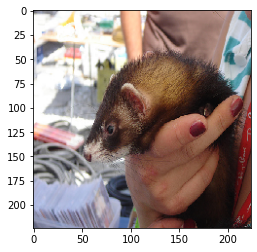

812


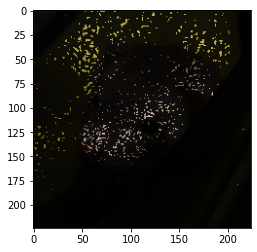

813


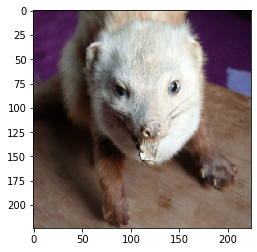

814


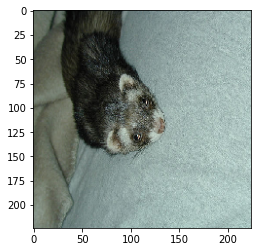

815


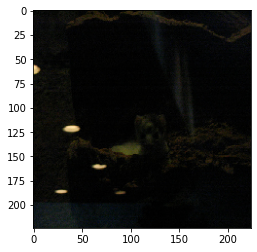

816


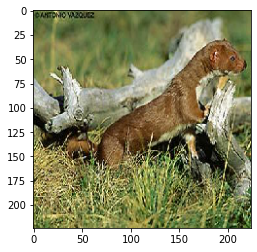

817


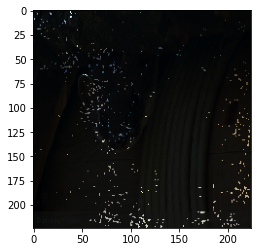

818


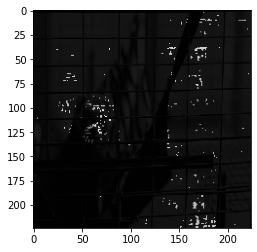

819


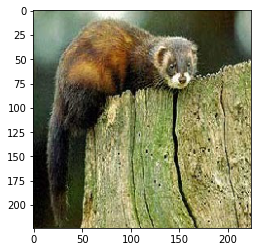

820


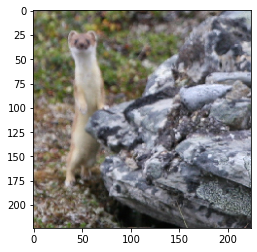

821


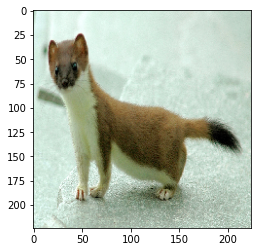

822


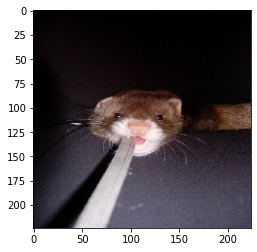

823


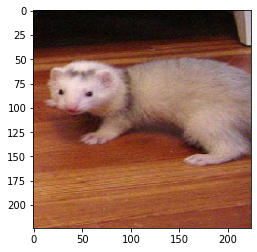

824


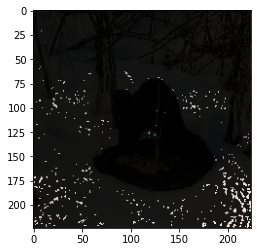

825


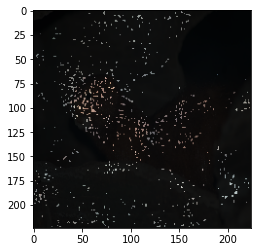

826


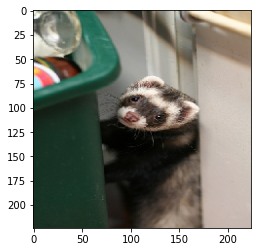

827


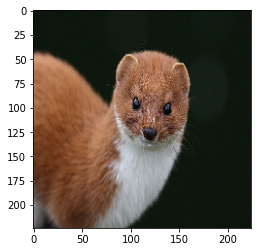

828


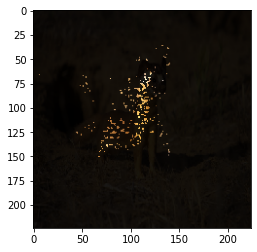

829


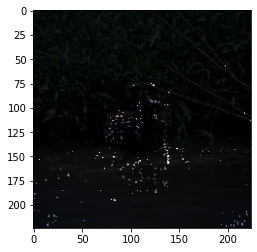

830


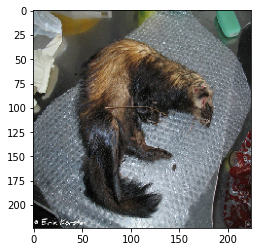

831


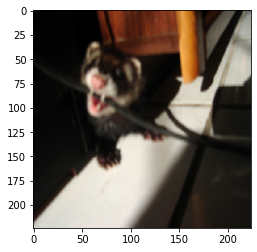

832


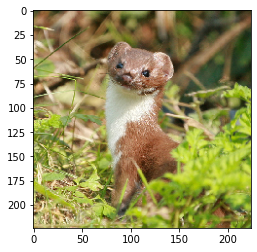

833


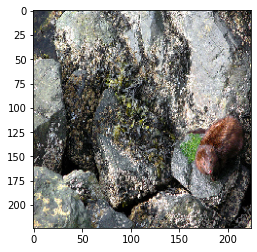

834


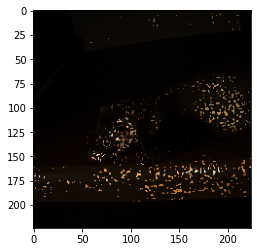

835


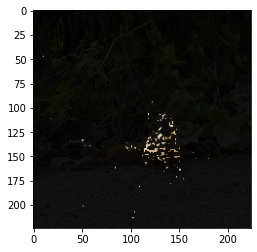

836


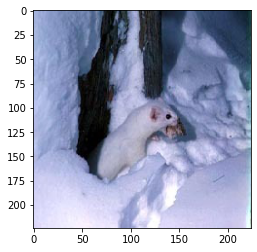

837


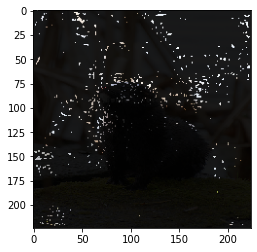

838


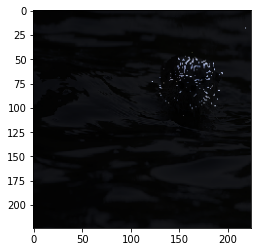

839


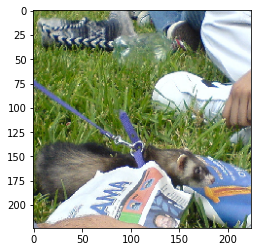

840


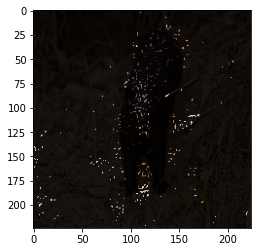

841


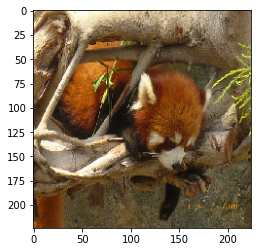

842


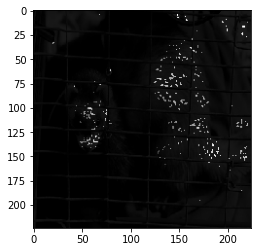

843


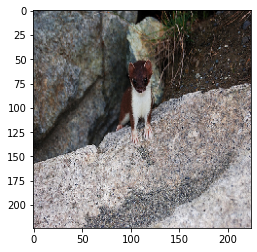

844


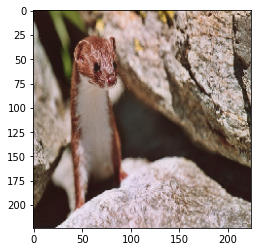

845


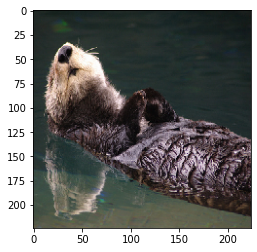

846


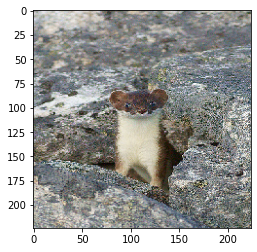

847


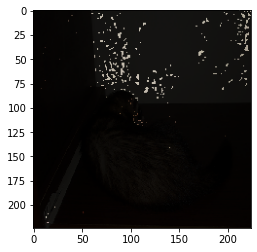

848


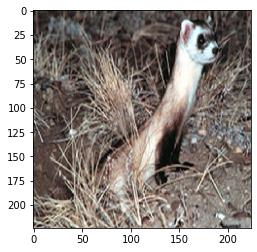

849


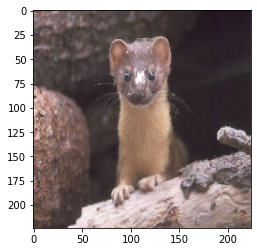

850


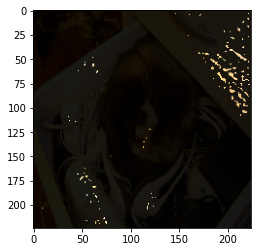

851


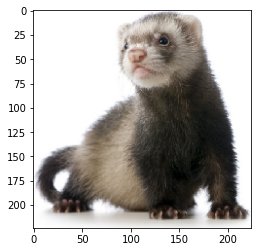

852


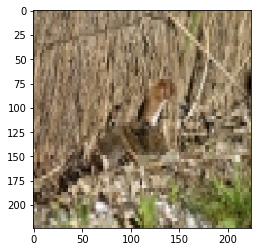

853


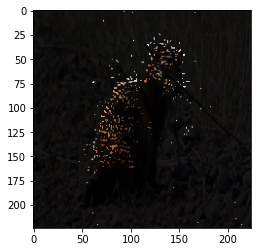

854


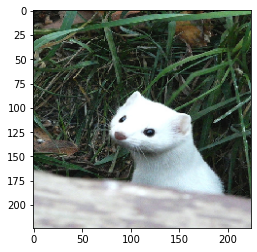

855


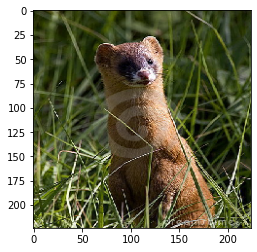

856


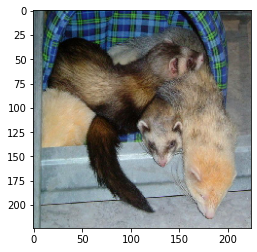

857


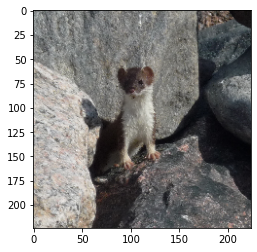

858


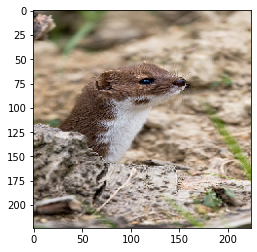

859


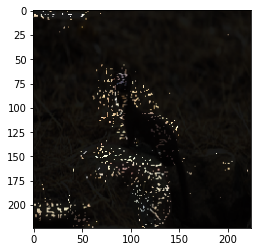

860


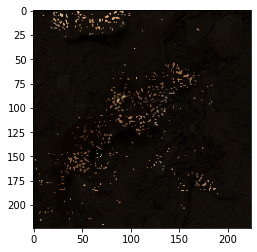

861


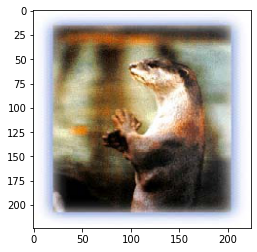

862


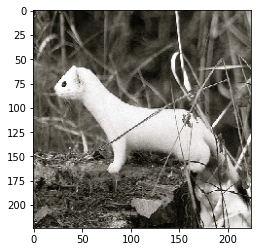

863


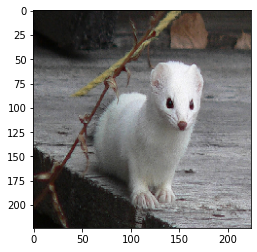

864


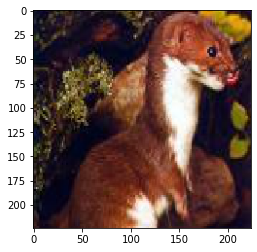

865


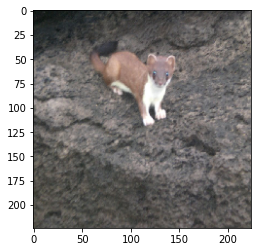

866


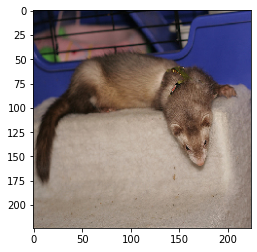

867


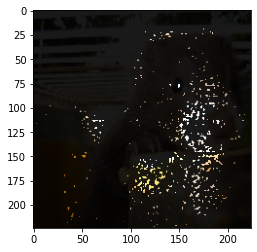

868


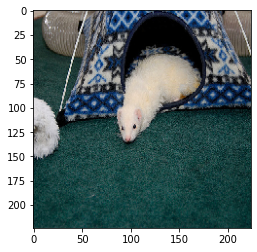

869


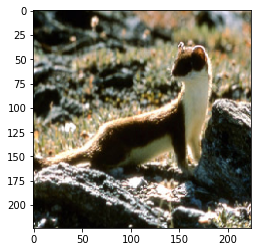

870


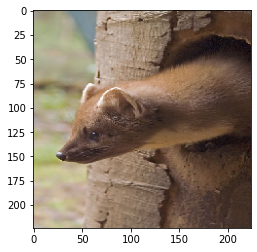

871


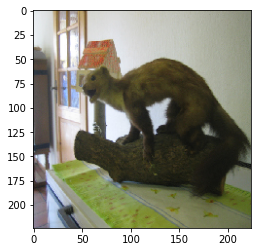

872


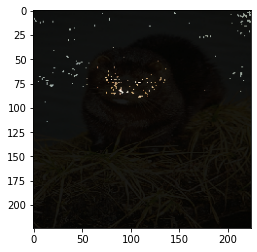

873


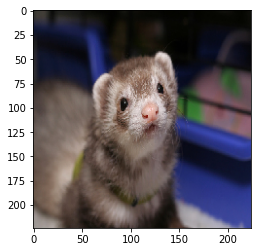

874


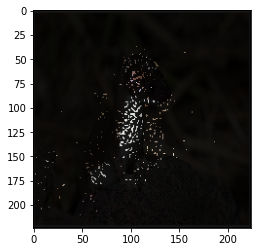

875


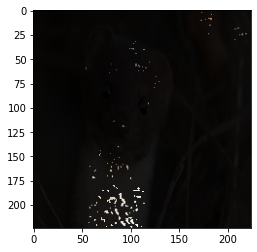

876


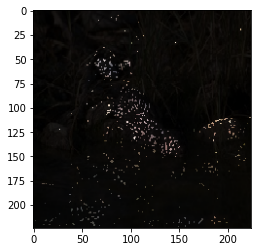

877


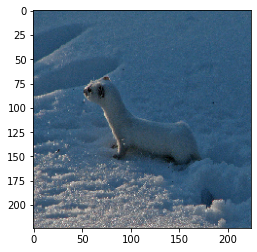

878


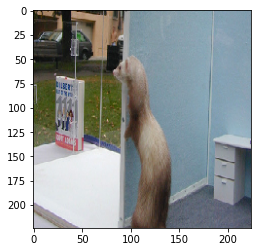

879


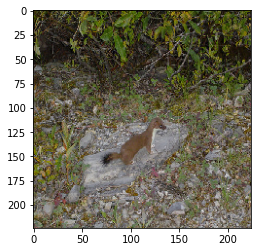

880


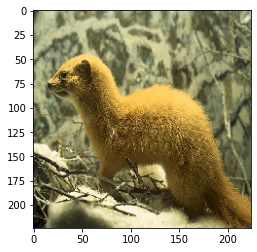

881


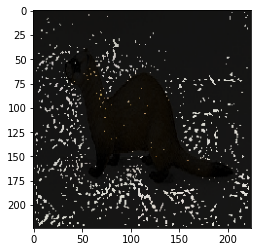

882


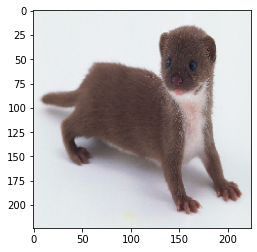

883


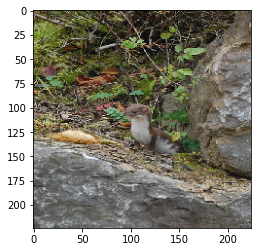

884


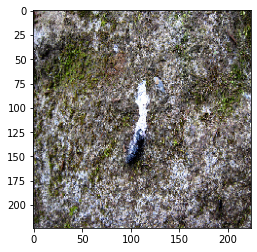

885


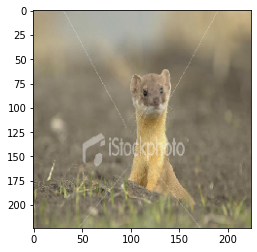

886


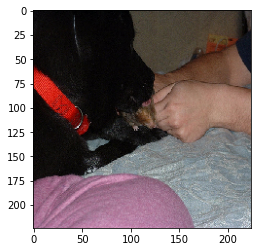

887


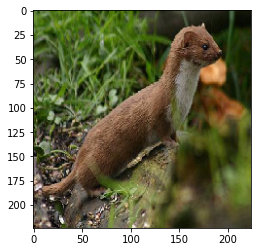

888


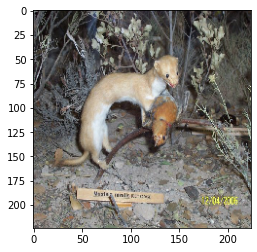

889


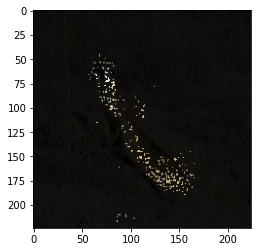

890


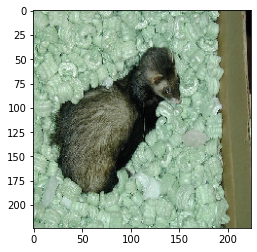

891


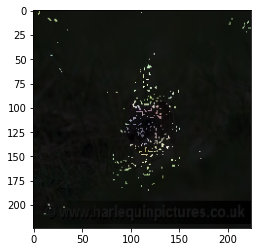

892


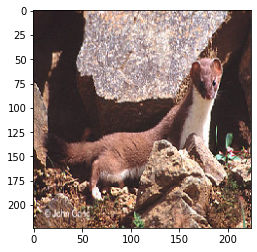

893


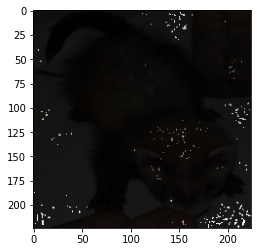

894


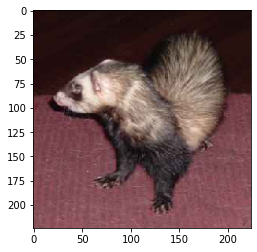

895


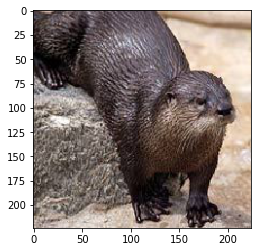

896


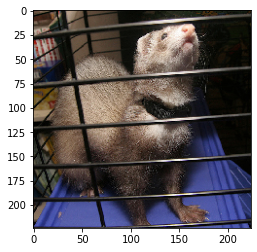

897


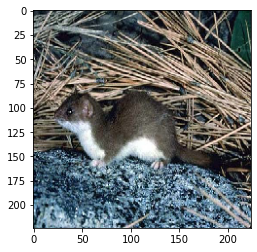

898


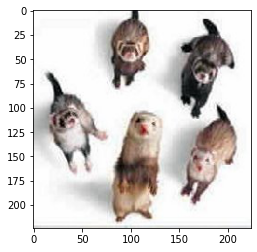

899


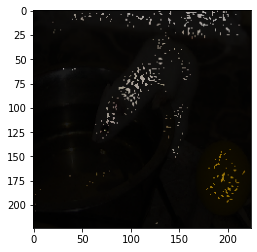

In [0]:
idx_start = 800
for index, img in enumerate(weasel_images):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_weasel_only[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [899, 848]
start_idx_weasel = 800
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_weasel_only[i-start_idx_weasel])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_weasel_only[i-start_idx_weasel].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Weasel_Target_Weasel_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

In [0]:
label = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    #expert_unit_all_camel = InfluenceD.dis_influence(image_set[0], 1)
    #print('Expert Neuron for all images: ', expert_unit_all_camel)
    #attr_map_all_camel = InfluenceD.expert_attribution(expert_unit_all_camel, all_images)
    expert_unit_camel_only = InfluenceD.dis_influence(camel_images, 1)
    print('Expert Neuron for camel images: ', expert_unit_camel_only)
    attr_map_camel_only = InfluenceD.expert_attribution(expert_unit_camel_only, camel_images)

In [0]:
idx_start = 600
idx_finish = 700
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_all_camel[index + idx_start].reshape(1, 224, 224, 3))
    #print(attr_map.shape)
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [525, 902, 622]
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_all_camel[i])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_all_camel[i].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Camel_Target_Whole_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

In [0]:
idx_start = 900
for index, img in enumerate(camel_images):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_camel_only[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

Report the indices of the expert neuron at fc_1 layer w.r.t. the camel and weasel classes, (B) when the distribution of interest is just the subset of camel or weasel images, respectively.


In [0]:
idx_for_img = [986, 965, 979]
start_idx_camel = 900
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_camel_only[i-start_idx_camel])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_camel_only[i-start_idx_camel].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Camel_Target_Camel_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

Written Exercise 12: Pick two related classes from the sample we provided different than camel or weasel. Which classes have you chosen? Report the same information as the previous exercise. For (B), use the appropriate subsets of only the classes you have chosen.

In [0]:
persian_cat_idx_list = []
siamese_cat_idx_list = []
for idx, label in enumerate(image_set[1]):
    if label == 283:
        persian_cat_idx_list.append(idx)
    if label == 284:
        siamese_cat_idx_list.append(idx)
persian_cat_images = np.zeros((len(persian_cat_idx_list), 224, 224, 3))
persian_images = np.asarray([image_set[0][idx] for idx in persian_cat_idx_list])
siamese_cat_images = np.zeros((len(siamese_cat_idx_list), 224, 224, 3))
siamese_images = np.asarray([image_set[0][idx] for idx in siamese_cat_idx_list])
print(persian_images.shape)
print(siamese_images.shape)
print(siamese_images)


In [0]:
plt.imshow(persian_images[0].reshape(224, 224, 3))
plt.show()

In [0]:
label = ImageNet_name2idx("Persian cat")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    expert_unit_all_persian = InfluenceD.dis_influence(image_set[0], 1)
    print('Expert Neuron for all images: ', expert_unit_all_persian)
    attr_map_all_persian = InfluenceD.expert_attribution(expert_unit_all_persian, all_images)
    expert_unit_persian_cat_only = InfluenceD.dis_influence(persian_images, 1)
    print('Expert Neuron for Persian cat images: ', expert_unit_persian_cat_only)
    attr_map_persian_cat_only = InfluenceD.expert_attribution(expert_unit_persian_cat_only, persian_images)

In [0]:
idx_start = 600
idx_finish = 700
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_all_persian[index + idx_start].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [689, 828, 754]
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_all_persian[i])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_all_persian[i].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Persian_Target_Whole_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

In [0]:
idx_for_img = [697, 674]
start_idx_persian = 600
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_persian_cat_only[i-start_idx_persian])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_persian_cat_only[i-start_idx_persian].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Persian_Target_Persian_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

In [0]:
label = ImageNet_name2idx("Siamese cat, Siamese")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    expert_unit_all_siamese = InfluenceD.dis_influence(image_set[0], 1)
    print('Expert Neuron for all images: ', expert_unit_all_siamese)
    attr_map_all_siamese = InfluenceD.expert_attribution(expert_unit_all_siamese, all_images)
    expert_unit_siamese_cat_only = InfluenceD.dis_influence(siamese_images, 1)
    print('Expert Neuron for Persian cat images: ', expert_unit_siamese_cat_only)
    attr_map_siamese_cat_only = InfluenceD.expert_attribution(expert_unit_siamese_cat_only, siamese_images)

Expert Neuron for all images:  3973
Expert Neuron for Persian cat images:  3973


In [0]:
idx_start = 900
idx_finish = 1000
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_all_siamese[index + idx_start].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [786, 180, 979]
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_all_siamese[i])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_all_siamese[i].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Siamese_Target_Whole_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

In [0]:
idx_start = 700
idx_finish = 800
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_siamese_cat_only[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [776, 738]
start_idx_siamese = 700
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_siamese_cat_only[i-start_idx_siamese])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_siamese_cat_only[i-start_idx_persian].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Siamese_Target_Siamese_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

Written Exercise 13: For the two classes you picked in the previous exercise, report and visualize the expert neuron (in the same layer) that distinguishes the first class from the second. You will need to use a quantity of interest that compares scores of the two classes. For the quantity of interest, use images from the (A) entire dataset and (B) only images belonging to one of your two classes. Also report your quantity of interest. Discuss what you observe: do the experts correspond to some human-understandable concept?
Did the differences in distribution of interest have any impact?

In [0]:
label = ImageNet_name2idx("Siamese cat, Siamese") - ImageNet_name2idx("Persian cat")
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    expert_unit_all_difference = InfluenceD.dis_influence(image_set[0], 1)
    print('Expert Neuron for all images: ', expert_unit_all_difference)
    attr_map_all_difference = InfluenceD.expert_attribution(expert_unit_all_difference, all_images)
    expert_unit_siamese_cat_only = InfluenceD.dis_influence(siamese_images, 1)
    print('Expert Neuron for Siamese cat images: ', expert_unit_siamese_cat_only)
    attr_map_siamese_cat_only = InfluenceD.expert_attribution(expert_unit_siamese_cat_only, siamese_images)

Expert Neuron for all images:  3630
Expert Neuron for Siamese cat images:  3630


In [0]:
idx_start = 600
idx_finish = 700
for index, img in enumerate(all_images[idx_start:idx_finish]):
    print(index + idx_start)
    map = binary_mask(img.reshape(1, 224, 224, 3), attr_map_all_difference[index].reshape(1, 224, 224, 3))
    plt.imshow(map.reshape(224, 224, 3))
    plt.show()

In [0]:
idx_for_img = [670, 671]
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_all_difference[i])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_all_difference[i].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Difference_Target_Whole_Dist_" + str(i) + '.png' 
    #plt.savefig(savefile)
    plt.show()

In [0]:
idx_for_img = [728, 721, 733]
start_idx_siamese = 700
for i in idx_for_img:
    point_cloud_img = point_cloud(attr_map_siamese_cat_only[i-start_idx_siamese])
    map = binary_mask(image_set[0][i].reshape(1, 224, 224, 3), attr_map_siamese_cat_only[i-start_idx_persian].reshape(1, 224, 224, 3))
    true_class = ImageNet_idx2name(image_set[1][i])
    print(true_class)
    subplot_list = [image_set[0][i], point_cloud_img, map.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Expert at fc_1', 'Visualization'], subplot_list):
        ax.imshow(img)
        ax.set_title(title)
        #ax.grid(True)
    savefile = "Difference_Target_Siamese_Dist_" + str(i) + '.png' 
    plt.savefig(savefile)
    plt.show()

Written Exercise 14: Use point_cloud and binary_mask methods to construct visualizations for Saliency Map, Integrated Gradient, Influence Directed Explanations attributions for the 10 different input images you selected, 5 from the correctly predicted sample and 5 from the incorrectly predicted sample. An example of Saliency Map is given below. DO label the visualizations with the method used and the ImageNet index of the images, and whether it is a correctly classified image nor not.

In [0]:
print(image_set[0].shape)

(1400, 224, 224, 3)


Figure out correct index for vgg net

In [0]:
correct_image_idx = [12228, 12510, 12727, 1504, 11436]
incorrect_image_idx = [2167, 10857, 1174, 11993, 10657]

a = [np.where(image_set[3]==idx) for idx in correct_image_idx]
print(a)
b = [np.where(image_set[3]==idx) for idx in incorrect_image_idx]
correct_idx_list_vgg_images = []
incorrect_idx_list_vgg_images = []

correct_idx_list = [115, 1114, 517, 314, 908]
print(correct_idx_list)
correct_images = np.zeros((len(correct_idx_list), 224, 224, 3))
correct_images = np.asarray([image_set[0][idx] for idx in correct_idx_list])
print(correct_images.shape)
for id in b:
    for j in range(len(id[0])):
        incorrect_idx_list_vgg_images.append(id[0][j])
incorrect_idx_list = [717, 807, 107, 511, 4]
#print(incorrect_idx_list)
# for img in incorrect_idx_list:
#     plt.imshow(image_set[0][img].reshape(224, 224, 3))
#     plt.show()
incorrect_images = np.zeros((len(incorrect_idx_list), 224, 224, 3))
incorrect_images = np.asarray([image_set[0][idx] for idx in incorrect_idx_list])
#print(incorrect_images.shape)


[(array([115]),), (array([1114, 1303]),), (array([ 517, 1011]),), (array([314]),), (array([908]),)]
[115, 1114, 517, 314, 908]
(5, 224, 224, 3)


Creating Saliency Map Visualization


In [0]:
idx_list = [115, 1114, 517, 314, 908, 717, 807, 107, 511, 4]
pred_label = [image_set[2][idx].astype(int) for idx in idx_list]
imgs = [image_set[0][idx].reshape(1, 224, 224, 3) for idx in idx_list]
saliency_map_combined = []
with tf.Session() as session:
    for i in range(len(idx_list)):
        model = get_model(session)
        salience3 = SaliencyMap(session, model.imgs, model.fc3l, pred_label[i])
        saliency_map3 = salience3(imgs[i], 16, True)
        saliency_map_combined.append(saliency_map3)
    


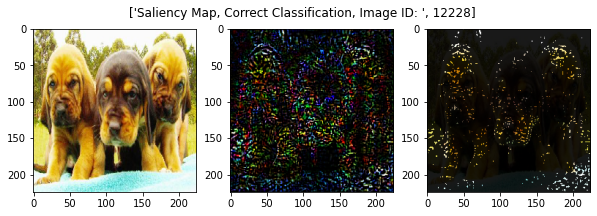

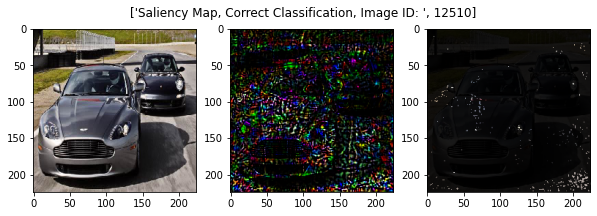

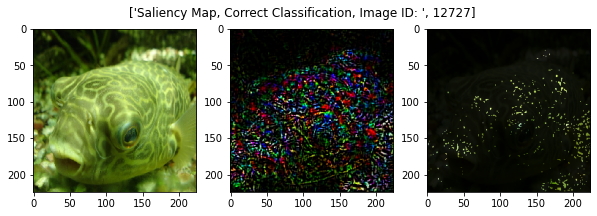

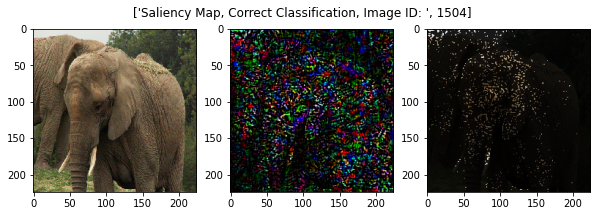

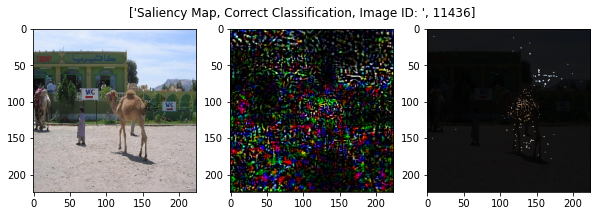

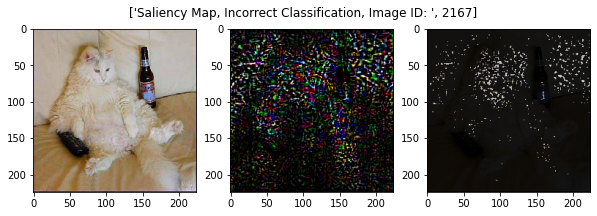

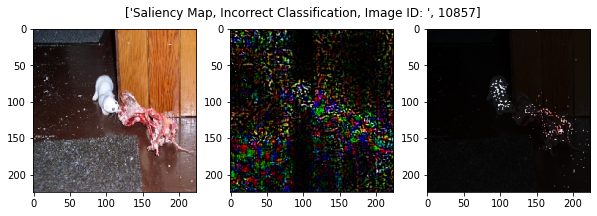

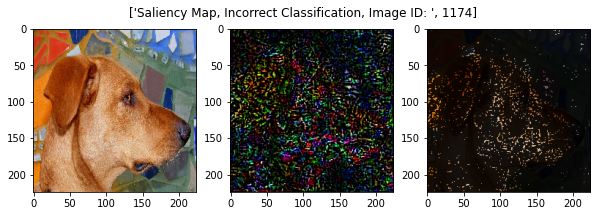

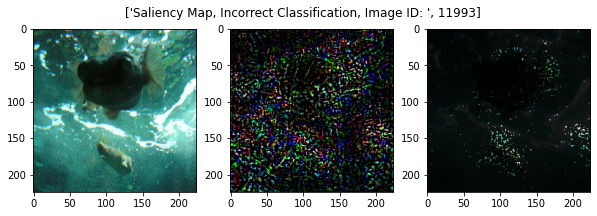

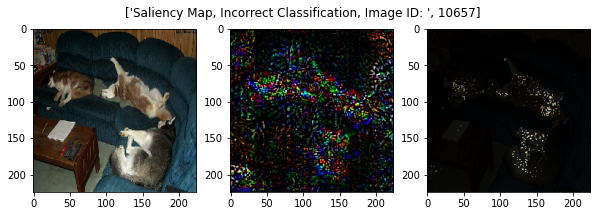

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
point_cloud_saliency = point_cloud(np.asarray(saliency_map_combined))
for idx, img in enumerate(imgs):
    map_saliency = binary_mask(imgs[idx].reshape(1, 224, 224, 3), saliency_map_combined[idx].reshape(1, 224, 224, 3))
    subplot_list = [imgs[idx].reshape(224, 224, 3), point_cloud_saliency[idx].reshape(224, 224, 3), map_saliency.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
        ax.imshow(img)
    if idx < 5:
        fig.suptitle(["Saliency Map, Correct Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Saliency_Map_Correct_" + str(image_net_idx[idx]) + '.png' 
    else:
        fig.suptitle(["Saliency Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Saliency_Map_Incorrect_" + str(image_net_idx[idx]) + '.png' 
    plt.savefig(savefile)
    plt.show()

Creating Integrated Gradient Visualization

In [0]:
idx_list = [115, 1114, 517, 314, 908, 717, 807, 107, 511, 4]
pred_label = [image_set[2][idx].astype(int) for idx in idx_list]
imgs = [image_set[0][idx].reshape(1, 224, 224, 3) for idx in idx_list]
IG_map_combined = []
with tf.Session() as session:
    for i in range(len(idx_list)):
        model = get_model(session)
        IG3 = IntegratedGrad(session, model.imgs, model.fc3l, pred_label[i])
        IG_map3 = IG3(imgs[i],'black', 16, 50, True)
        IG_map_combined.append(IG_map3)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


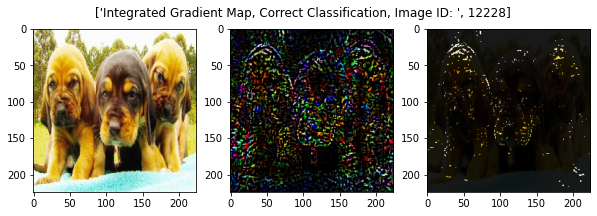

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


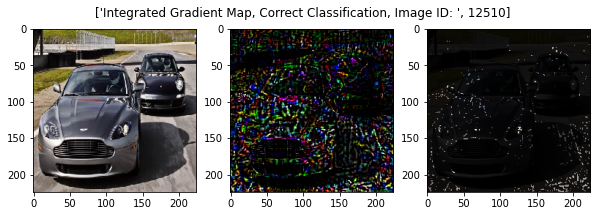

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


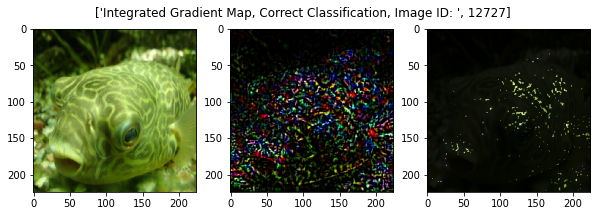

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


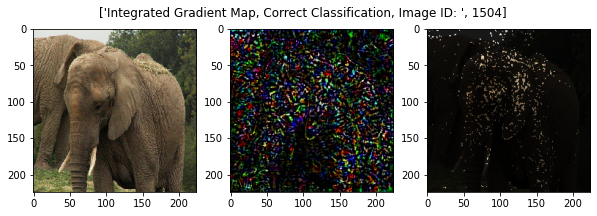

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


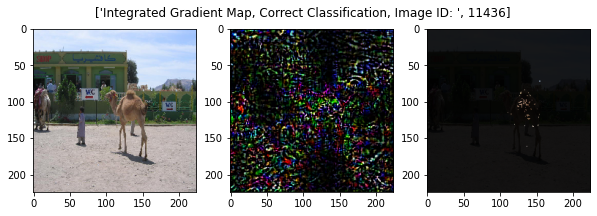

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


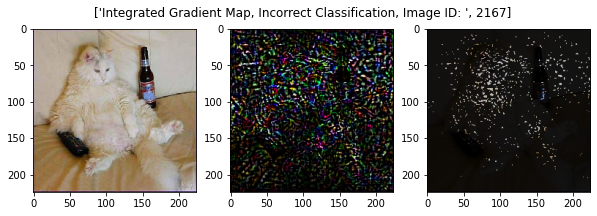

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


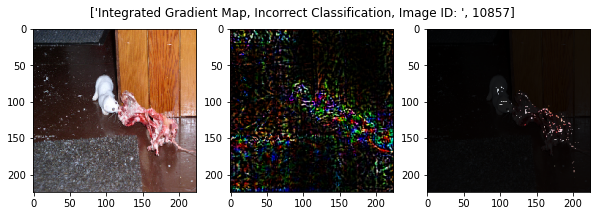

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


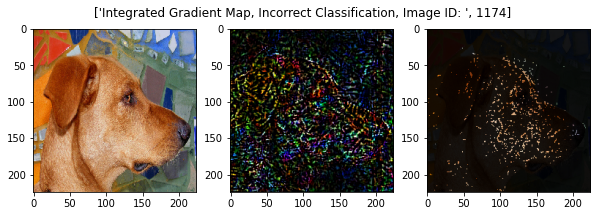

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


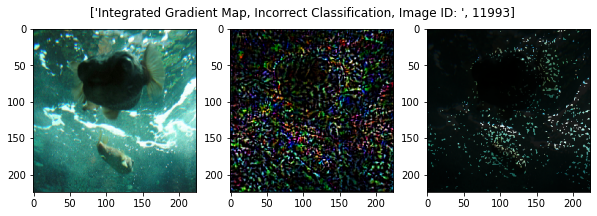

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


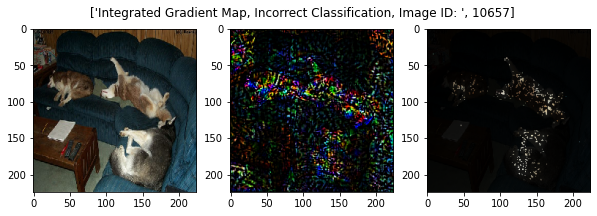

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
point_cloud_IG3 = point_cloud(np.asarray(IG_map_combined))
for idx, img in enumerate(imgs):
    map_IG = binary_mask(imgs[idx].reshape(1, 224, 224, 3), IG_map_combined[idx].reshape(1, 224, 224, 3))
    subplot_list = [imgs[idx].reshape(224, 224, 3), point_cloud_IG3[idx].reshape(224, 224, 3), map_IG.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
        ax.imshow(img)
    if idx < 5:
        fig.suptitle(["Integrated Gradient Map, Correct Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Integrated_Gradient_Map_Correct_" + str(image_net_idx[idx]) + '.png'
    else:
        fig.suptitle(["Integrated Gradient Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Integrated_Gradient_Map_Incorrect_" + str(image_net_idx[idx]) + '.png'
    plt.savefig(savefile)
    plt.show()

Creating Visualizations for Influence Directed Attribution

In [0]:
idx_list = [115, 1114, 517, 314, 908, 717, 807, 107, 511, 4]
pred_label = [image_set[2][idx].astype(int) for idx in idx_list]
imgs = [image_set[0][idx].reshape(1, 224, 224, 3) for idx in idx_list]
Infl_map_combined = []
with tf.Session() as session:
    for i in range(len(idx_list)):
        model = get_model(session)
        InfluenceD3 = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x:x[pred_label[i]])
        expert_unit_infl = InfluenceD3.dis_influence(image_set[0], 1)
        print('Expert Neuron for all images: ', expert_unit_infl)
        attr_map_infl = InfluenceD3.expert_attribution(expert_unit_infl, imag[i])
        Infl_map_combined.append(attr_map_infl)

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
point_cloud_infl3 = point_cloud(np.asarray(Infl_map_combined))
for idx, img in enumerate(imgs):
    map_Infl = binary_mask(imgs[idx].reshape(1, 224, 224, 3), Infl_map_combined[idx].reshape(1, 224, 224, 3))
    subplot_list = [imgs[idx].reshape(224, 224, 3), point_cloud_infl3[idx].reshape(224, 224, 3), map_Infl.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
        ax.imshow(img)
    if idx < 5:
        fig.suptitle(["Influence Directed Map, Correct Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Correct_" + str(image_net_idx[idx]) + '.png'
    else:
        fig.suptitle(["Influence Directed Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Incorrect_" + str(image_net_idx[idx]) + '.png'
    #plt.savefig(savefile)
    plt.show()

In [0]:
dist_influence_idx = range(0,1400,4)
idx_list = [115, 1114, 517, 314, 908, 717, 807, 107, 511, 4]
imgs = [image_set[0][idx].reshape(1, 224, 224, 3).astype(float) for idx in idx_list]
pred_label = [image_set[2][idx].astype(int) for idx in idx_list]
dist_imgs = np.array([image_set[0][idx].astype(float) for idx in dist_influence_idx])
attr_map_combined = []
with tf.Session() as session:
    model = get_model(session)
    InfluenceD3 = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x:x[pred_label[0]])
    expert_unit_infl = InfluenceD3.dis_influence(image_set[0].astype(float), 1)
    print('Expert Neuron for all images: ', expert_unit_infl)
    for idx in range(10):
        attr_map_infl = InfluenceD3.expert_attribution(expert_unit_infl, imgs[idx].reshape(1, 224, 224, 3))
        attr_map_combined.append(attr_map_infl)

Expert Neuron for all images:  481


In [0]:
print(attr_map_combined[1])

[[[[ 1.38789485e-03  8.35057232e-04  6.55329204e-04]
   [-1.03545829e-03 -1.33534591e-03 -1.37962296e-03]
   [-2.28830287e-03 -2.31182436e-03 -8.90652474e-04]
   ...
   [ 2.86172261e-04 -4.30678204e-03 -1.57009764e-03]
   [ 1.06972549e-03 -1.16138224e-04 -1.06705888e-03]
   [ 2.62966496e-03  2.85944296e-03 -6.91883615e-05]]

  [[ 2.00574240e-03  1.17280998e-03  7.20817654e-04]
   [ 1.99043192e-03  1.54782506e-03  5.66223694e-04]
   [-1.57480454e-03 -1.13448408e-03  2.47915043e-04]
   ...
   [ 1.01030087e-02  4.97388514e-03  0.00000000e+00]
   [ 9.40105505e-03  7.71742873e-03  0.00000000e+00]
   [ 3.61433020e-03  3.70922964e-03  6.34663138e-06]]

  [[-1.17246716e-04 -1.39890239e-03 -1.30113272e-03]
   [ 4.61655250e-03  3.25570325e-03  2.14402867e-03]
   [ 1.68640027e-03  1.41694536e-03  2.47211009e-03]
   ...
   [ 1.13486899e-02 -2.16921535e-03  1.01648817e-04]
   [ 1.82850938e-02  1.19840959e-02  2.26174202e-03]
   [ 5.07912599e-03  3.54456669e-03 -9.25662534e-05]]

  ...

  [[ 5.63609

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


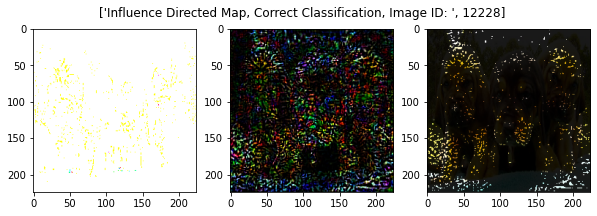

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


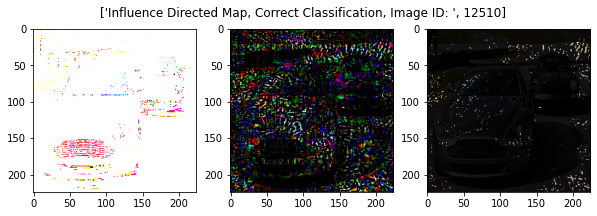

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


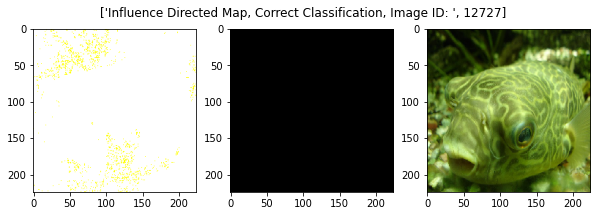

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


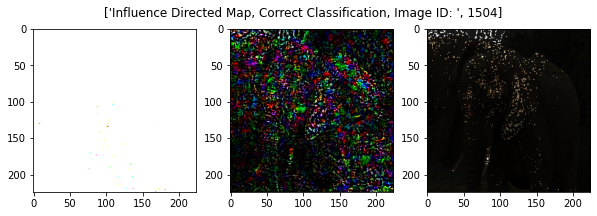

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


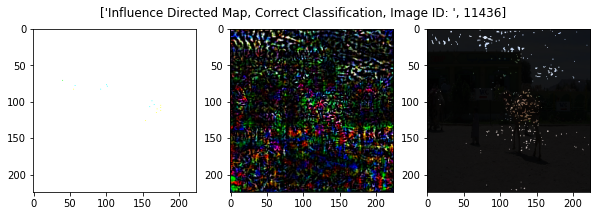

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


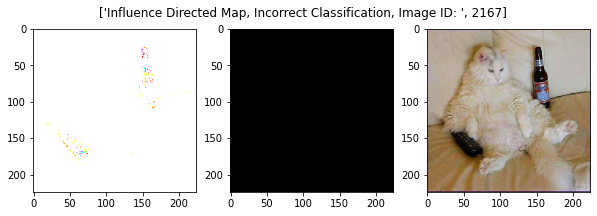

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


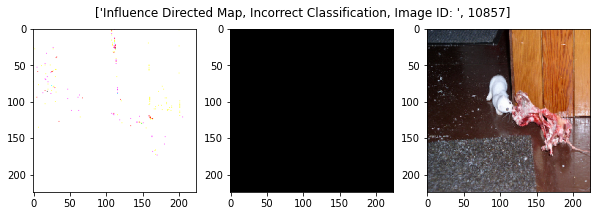

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


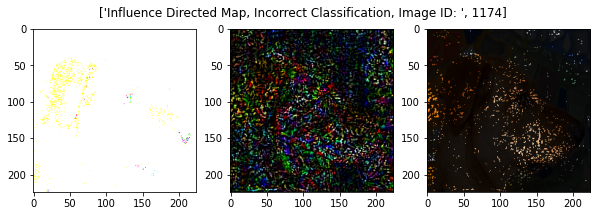

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


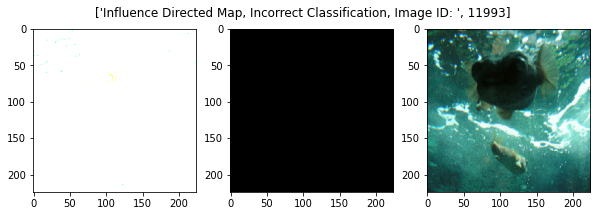

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


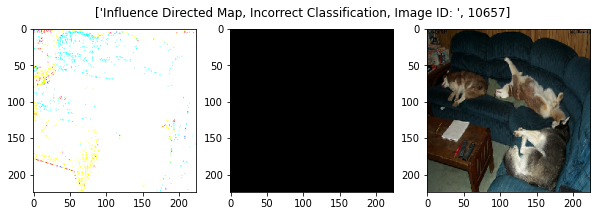

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
point_cloud_infl3 = point_cloud(np.asarray(attr_map_combined)) #.reshape(224, 224, 3))
for idx in range(10):
    
    map_Infl = binary_mask(imgs[idx].reshape(1, 224, 224, 3), attr_map_combined[idx].reshape(1, 224, 224, 3))
    subplot_list = [imgs[idx].reshape(224, 224, 3), point_cloud_infl3[idx].reshape(224, 224, 3), map_Infl.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
        ax.imshow(img)
    if idx < 5:
        fig.suptitle(["Influence Directed Map, Correct Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Correct_" + str(image_net_idx[idx]) + '.png'
    else:
        fig.suptitle(["Influence Directed Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Incorrect_" + str(image_net_idx[idx]) + '.png'
    #plt.savefig(savefile)
    plt.show()

Coding Exercise 16. [3 points] Implement this evaluation metric with AverageDrop in hw3_evaluation.py.

In [0]:
def AverageDrop(sess, attr_map, input,
                input_tensor, output_tensor,
                target_class):
    """Implementation of Average Drop %

    https://arxiv.org/abs/1710.11063

    Arguments:
        sess {tf.Session} -- tensorflow session
        attr_map {np.ndarray} -- NxHxW, the attribution maps for input
        input {np.ndarray} -- NxHxWxC, the input dataset
        input_tensor {tf.Tensor} -- Symbolic tensor of input node
        output_tensor {tf.Tensor} -- Symbolic tensor of pre-softmax output
        target_class: {int} -- Class of Interest

    Returns:
        float -- average drop % score
    """
    score = None
    # >>> Your code starts here <<<
    N = input.shape[0]
    attr_map = np.expand_dims(attr_map, axis=attr_map.ndim)
    Ma_x = binary_mask(input, attr_map, False, True, 0, 0.0, 0.0)
    attr_score = sess.run(output_tensor[:, target_class], feed_dict={input_tensor: input})
    mask_score = sess.run(output_tensor[:, target_class], feed_dict={input_tensor: Ma_x})
    idx_subtract = attr_score - mask_score
    score1 = np.maximum(idx_subtract, 0) / attr_score
    score = 100 * np.sum(score1)/N   
    
    
    # score_list = []
    
    # for attribution, image in zip(attr_map, input):
    #   print(attribution.shape)
    #   attribution = np.expand_dims(attribution, axis = attribution.ndim)
    #   print(attribution.shape)
    #   attr_map = np.expand_dims(attribution, axis = 0)
    #   x_batch = np.expand_dims(image, axis = 0)
    #   Ma_x = binary_mask(x_batch, attr_map, False, True, 0, 0.0, 0.0)
    #   attr_score = sess.run(output_tensor[:, target_class], feed_dict={input_tensor: x_batch})
    #   mask_score = sess.run(output_tensor[:, target_class], feed_dict={input_tensor: Ma_x})
    #   idx_subtract = attr_score - mask_score
    #   score1 = np.maximum(idx_subtract, 0) / attr_score
    #   score_list.append(score1)
    # score = 100 * np.sum(np.asarray(score_list))/N   
    # >>> Your code ends here <<<
    return score

Written Exercise 17. [2 points] Use your implementation to compute the average drop score for the 100 images of a class of your choosing for the three attribution methods of Section 3.1. Report the class you chose and the scores in the written part. This should be a 3 by 1 table.

In [0]:
label = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
with tf.Session() as session:
  model = get_model(session)
  integrated_grad = IntegratedGrad(session, model.imgs, model.fc3l, label)
  ig_map = integrated_grad(camels)
  ig = np.mean(ig_map, axis=-1)
  avg_drop_integrated_grad = AverageDrop(session, ig, camels, model.imgs, model.fc3l, label)

(100,)
(100,)


In [0]:
print(np.expand_dims(ig, axis=ig.ndim).shape)

(100, 224, 224, 1)


In [0]:
print(avg_drop_integrated_grad)

93.28114318847656


In [0]:
label = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
with tf.Session() as session:
  model = get_model(session)
  saliency = SaliencyMap(session, model.imgs, model.fc3l, label)
  saliency_map = saliency(camels)
  sal = np.mean(saliency_map, axis=-1)
  avg_drop_saliency = AverageDrop(session, sal, camels, model.imgs, model.fc3l, label)

(100, 224, 224, 3)


In [0]:
print(avg_drop_saliency)

95.51199340820312


In [0]:
abel = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
#camel_images_reshape = [camel_images[i].reshape(224, 224, 3) for i in range(len(camel_images))]
#print(camel_images.shape)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD3 = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x:x[label])
    expert_unit_infl = InfluenceD3.dis_influence(camels.astype(float), 1)
    print('Expert Neuron for all images: ', expert_unit_infl)
    attr_map_infl = InfluenceD3.expert_attribution(expert_unit_infl, camels)
    infl = np.mean(attr_map_infl, axis=-1)
    avg_drop_influence_directed = AverageDrop(session, infl, camels, model.imgs, model.fc3l, label)

In [0]:
print(avg_drop_influence_directed)

89.27474212646484


In [0]:
images = load_ImageNet()

weasel_indexes = []
camel_indexes = []
persian_indexes = []
siamese_indexes = []
for idx, label in enumerate(images[1]):
    if label == 356:
        weasel_indexes.append(idx)
    if label == 354:
        camel_indexes.append(idx)
    if label == 283:
        persian_indexes.append(idx)
    if label == 284:
        siamese_indexes.append(idx)
weasels = np.zeros((len(weasel_indexes), 224, 224, 3))
weasels = np.asarray([images[0][idx] for idx in weasel_indexes]).astype(float)
camels = np.zeros((len(camel_indexes), 224, 224, 3))
camels = np.asarray([images[0][idx] for idx in camel_indexes]).astype(float)
persian_cat = np.zeros((len(persian_indexes), 224, 224, 3))
persian_cat = np.asarray([images[0][idx] for idx in persian_indexes]).astype(float)
siamese_cat = np.zeros((len(siamese_indexes), 224, 224, 3))
siamese_cat = np.asarray([images[0][idx] for idx in siamese_indexes]).astype(float)
all_images = np.zeros((len(images[0]), 224, 224, 3))
all_images = np.asarray([images[0][idx] for idx in range(len(images[0]))]).astype(float)



Weasel Images Influence Directed

In [0]:
label = ImageNet_name2idx("weasel")
print(label)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x: x[label])
    expert_unit_all_weasel = InfluenceD.dis_influence(images[0], 1)
    print('Expert Neuron for All Images in Weasel DoI: ', expert_unit_all_weasel)
    attr_map_weasel_all = InfluenceD.expert_attribution(expert_unit_all_weasel, all_images)
    expert_unit_weasel_only = InfluenceD.dis_influence(weasels, 1)
    print('Expert Neuron for Weasel Images: ', expert_unit_weasel_only)
    attr_map_weasel_only = InfluenceD.expert_attribution(expert_unit_weasel_only, weasels)

356
Expert Neuron for All Images in Weasel DoI:  3739
Expert Neuron for Weasel Images:  1982


Camel Images Influence Directed

In [0]:
label = ImageNet_name2idx("Arabian camel, dromedary, Camelus dromedarius")
print(label)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x: x[label])
    expert_unit_all_camel = InfluenceD.dis_influence(images[0], 1)
    print('Expert Neuron for All Images in Camel DoI: ', expert_unit_all_camel)
    attr_map_camel_all = InfluenceD.expert_attribution(expert_unit_all_camel, all_images)
    expert_unit_camel_only = InfluenceD.dis_influence(camels, 1)
    print('Expert Neuron for Camel images: ', expert_unit_camel_only)
    attr_map_camel_only = InfluenceD.expert_attribution(expert_unit_camel_only, camels)

354
Expert Neuron for All Images in Camel DoI:  1425
Expert Neuron for Camel images:  1425


Persian Cat Influence Directed


In [0]:
label = ImageNet_name2idx("Persian cat")
print(label)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x: x[label])
    expert_unit_all_persian = InfluenceD.dis_influence(images[0], 1)
    print('Expert Neuron for All Images in Persian Cat DoI: ', expert_unit_all_persian)
    attr_map_persian_all = InfluenceD.expert_attribution(expert_unit_all_persian, all_images)
    expert_unit_persian_only = InfluenceD.dis_influence(persian_cat, 1)
    print('Expert Neuron for Persian images: ', expert_unit_persian_only)
    attr_map_persian_only = InfluenceD.expert_attribution(expert_unit_persian_only, persian_cat)

283
Expert Neuron for All Images in Persian Cat DoI:  694
Expert Neuron for Persian images:  929


Siamese Cat Influence Directed

In [0]:
label = ImageNet_name2idx("Siamese cat, Siamese") 
print(label)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x: x[label])
    expert_unit_all_siamese = InfluenceD.dis_influence(images[0], 1)
    print('Expert Neuron for All Images in Difference Cat DoI: ', expert_unit_all_siamese)
    attr_map_all_siamese = InfluenceD.expert_attribution(expert_unit_all_siamese, all_images)
    expert_unit_siamese_only = InfluenceD.dis_influence(siamese_cat, 1)
    print('Expert Neuron for Siamese Cat images: ', expert_unit_siamese_only)
    attr_map_siamese_only = InfluenceD.expert_attribution(expert_unit_siamese_only, siamese_cat)

In [0]:
label = ImageNet_name2idx("Siamese cat, Siamese") - ImageNet_name2idx("Persian cat")
print(label)
with tf.Session() as session:
    model = get_model(session)
    InfluenceD = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x: x[label])
    expert_unit_all_difference = InfluenceD.dis_influence(images[0], 1)
    print('Expert Neuron for All Images in Difference Cat DoI: ', expert_unit_all_difference)
    attr_map_difference_all = InfluenceD.expert_attribution(expert_unit_all_difference, all_images)
    expert_unit_siamese_only = InfluenceD.dis_influence(siamese_cat, 1)
    print('Expert Neuron for Siamese Cat images: ', expert_unit_siamese_only)
    attr_map_siamese = InfluenceD.expert_attribution(expert_unit_siamese_only, siamese_cat)

1
Expert Neuron for All Images in Difference Cat DoI:  3630
Expert Neuron for Siamese Cat images:  3630


In [0]:
print(attr_map_siamese[1].shape)

(224, 224, 3)


In [0]:
def plot_visualization(class_index, class_doi_attr_map, all_images_set):
    class_map = binary_mask(all_images[class_index].reshape(1, 224, 224, 3),
                                class_doi_attr_map[class_index].reshape(1, 224, 224, 3))
    point_cloud_image = point_cloud(class_doi_attr_map[class_index])
    true_label = ImageNet_idx2name(images[1][class_index])
    plots = [all_images_set[class_index].reshape(224, 224, 3).astype(int), point_cloud_image, class_map.reshape(224, 224, 3)]
    fig, axes = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axes, ['Original Input ' , 'Expert at fc_1 ',
                                         'visualization '], plots):
        ax.imshow(img)
        ax.set_title(title)
        ax.grid(False)
    file_to_save = "Difference_Cat_Target_Whole_Dist_" + str(class_index) + '.png'
    plt.savefig(file_to_save)
    print("File Saved", file_to_save)
    plt.show()

In [0]:
def plot_visualization_subset(class_index, class_doi_attr_map, class_images):
    class_map = binary_mask(class_images[class_index].reshape(1, 224, 224, 3),
                                class_doi_attr_map[class_index].reshape(1, 224, 224, 3))
    point_cloud_image = point_cloud(class_doi_attr_map[class_index])
    true_label = ImageNet_idx2name(images[1][class_index])
    plots = [class_images[class_index].reshape(224, 224, 3).astype(int), point_cloud_image, class_map.reshape(224, 224, 3)]
    fig, axes = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axes, ['Original Input ' , 'Expert at fc_1 ',
                                         'visualization '], plots):
        ax.imshow(img)
        ax.set_title(title)
        ax.grid(False)
    file_to_save = "Difference_Cat_Target_Siamese_Cat_Dist_" + str(class_index) + '.png'
    plt.savefig(file_to_save)
    print("File Saved", file_to_save)
    plt.show()

In [0]:
weasel_plot_all = [18, 384, 887]
for idx in weasel_plot_all:
    plot_visualization(idx, attr_map_weasel_all, all_images)
weasel_plot_weasel_only = [99, 48]
for idx in weasel_plot_weasel_only:
    plot_visualization_subset(idx, attr_map_weasel_only, weasels)

In [0]:
camel_plot_all = [525, 902, 622]
for idx in camel_plot_all:
    plot_visualization(idx, attr_map_camel_all, all_images)
camel_plot_subset = [86, 81, 79]
for idx in camel_plot_subset:
    plot_visualization_subset(idx, attr_map_camel_only, camels)

In [0]:
persian_plot_all = [689, 828, 754, 887]
for idx in persian_plot_all:
    plot_visualization(idx, attr_map_persian_all, all_images)
persian_plot_subset = [97, 86, 89, 84, 83, 78, 74]
for idx in persian_plot_subset:
    plot_visualization_subset(idx, attr_map_persian_only, persian_cat)

In [0]:
siamese_plot_all = [790, 180, 161, 130, 979]
for idx in siamese_plot_all:
    plot_visualization(idx, attr_map_siamese_all, all_images)
siamese_plot_subset = [62, 60, 38]
for idx in siamese_plot_subset:
    plot_visualization_subset(idx, attr_map_siamese_only, siamese_cat)

In [0]:
difference_plot_all = [797, 786, 771, 98, 62, 541, 525, 514]
for idx in difference_plot_all:
    plot_visualization(idx, attr_map_difference_all, all_images)
difference_plot_subset = [28, 21, 33, 24]
for idx in difference_plot_subset:
    plot_visualization_subset(idx, attr_map_siamese, siamese_cat)

Expert Neuron for all images:  3311


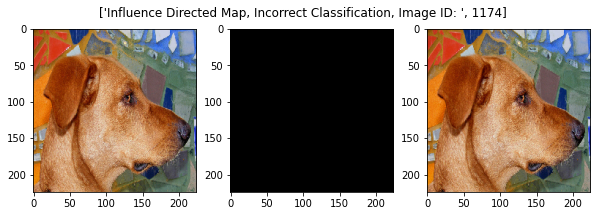

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Expert Neuron for all images:  3401


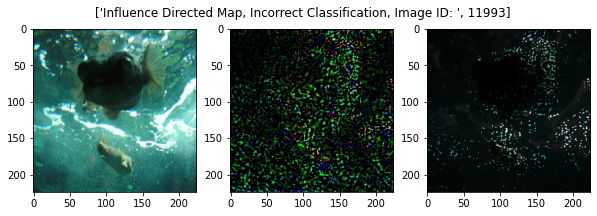

Expert Neuron for all images:  1989


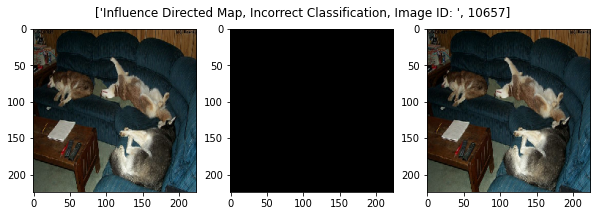

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
idx_list = [115, 1114, 517, 314, 908, 717, 807, 107, 511, 4]
imgs = np.array([image_set[0][idx] for idx in idx_list])
pred_label = [image_set[2][idx].astype(int) for idx in idx_list]
#dist_imgs = np.array([image_set[0][idx] for idx in dist_influence_idx])
attr_map_combined = []
#im_num = 1
for im_num in range(len(idx_list)):
    with tf.Session() as session:
        if im_num > 6:
            model = get_model(session)
            InfluenceD3 = InflDirected2(session, model.imgs, model.fc1, model.fc3l, lambda x:x[pred_label[im_num]])
            expert_unit_infl = InfluenceD3.dis_influence(image_set[0].astype(float), 1)
            print('Expert Neuron for all images: ', expert_unit_infl)
            attr_map_infl = InfluenceD3.expert_attribution(expert_unit_infl, imgs[im_num].reshape(1, 224, 224, 3).astype(float))
            map_Infl = binary_mask(imgs[im_num].reshape(1, 224, 224, 3), attr_map_infl.reshape(1, 224, 224, 3))
            point_cloud_image = point_cloud(attr_map_infl.reshape(224, 224, 3))
            subplot_list = [imgs[im_num].reshape(224, 224, 3), point_cloud_image, map_Infl.reshape(224, 224, 3)]
            fig, axs = plt.subplots(1, 3, figsize=(10, 3))
            for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
                ax.imshow(img)
            if im_num < 5:
                fig.suptitle(["Influence Directed Map, Correct Classification, Image ID: ", image_net_idx[im_num]])
                savefile = "Influence_Directed_Map_Correct_" + str(image_net_idx[im_num]) + '.png'
            else:
                fig.suptitle(["Influence Directed Map, Incorrect Classification, Image ID: ", image_net_idx[im_num]])
                savefile = "Influence_Directed_Map_Incorrect_" + str(image_net_idx[im_num]) + '.png'
            plt.savefig(savefile)
            plt.show()

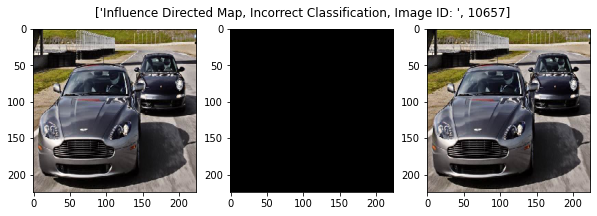

In [0]:
map_Infl = binary_mask(imgs[im_num].reshape(1, 224, 224, 3), attr_map_infl.reshape(1, 224, 224, 3))
point_cloud_image = point_cloud(attr_map_infl.reshape(224, 224, 3))
subplot_list = [imgs[im_num].reshape(224, 224, 3), point_cloud_image, map_Infl.reshape(224, 224, 3)]
fig, axs = plt.subplots(1, 3, figsize=(10, 3))
for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
    ax.imshow(img)
if idx < 5:
    fig.suptitle(["Influence Directed Map, Correct Classification, Image ID: ", image_net_idx[idx]])
    savefile = "Influence_Directed_Map_Correct_" + str(image_net_idx[idx]) + '.png'
else:
    fig.suptitle(["Influence Directed Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
    savefile = "Influence_Directed_Map_Incorrect_" + str(image_net_idx[idx]) + '.png'
#plt.savefig(savefile)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


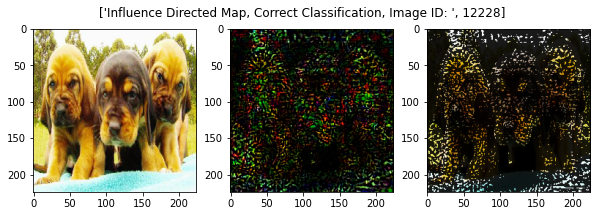

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


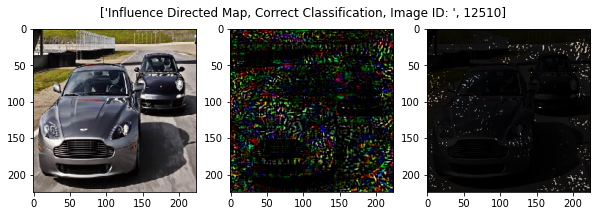

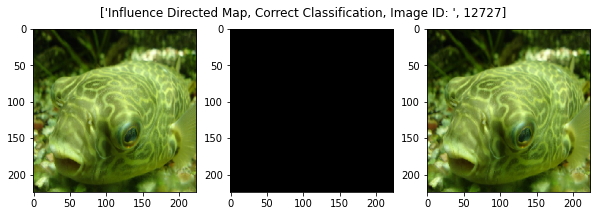

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


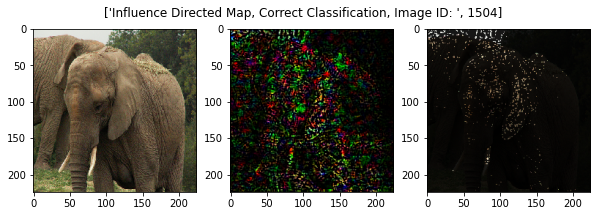

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


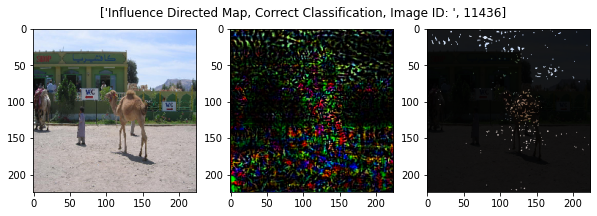

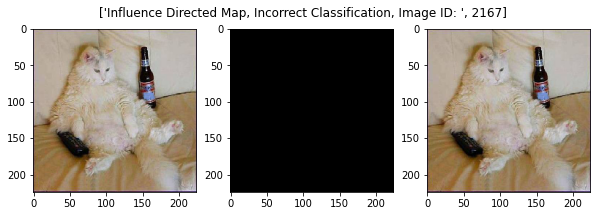

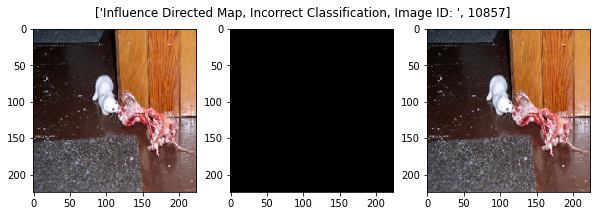

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


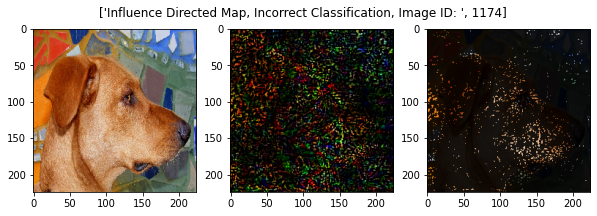

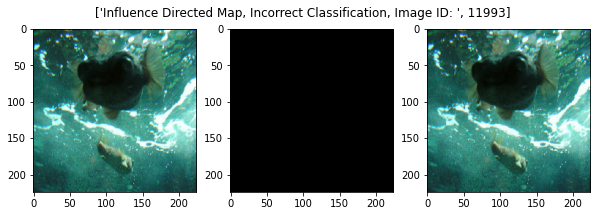

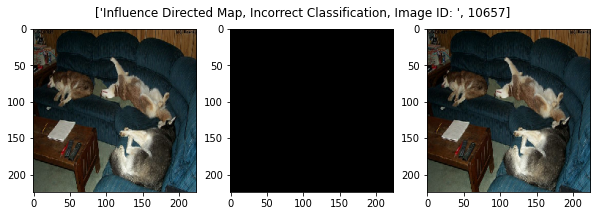

In [0]:
image_net_idx = [12228, 12510, 12727, 1504, 11436, 2167, 10857, 1174, 11993, 10657]
#point_cloud_infl3 = point_cloud(np.asarray(attr_map_combined)) #.reshape(224, 224, 3))
for idx in range(len(image_net_idx)):
    map_Infl = binary_mask(imgs[idx].reshape(1, 224, 224, 3), attr_map_infl[idx].reshape(1, 224, 224, 3))
    point_cloud_image = point_cloud(attr_map_infl[idx])
    subplot_list = [imgs[idx].reshape(224, 224, 3), point_cloud_image, map_Infl.reshape(224, 224, 3)]
    fig, axs = plt.subplots(1, 3, figsize=(10, 3))
    for ax, title, img in zip(axs, ['Original Image', 'Point Cloud', 'Binary Mask'], subplot_list):
        ax.imshow(img)
    if idx < 5:
        fig.suptitle(["Influence Directed Map, Correct Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Correct_" + str(image_net_idx[idx]) + '.png'
    else:
        fig.suptitle(["Influence Directed Map, Incorrect Classification, Image ID: ", image_net_idx[idx]])
        savefile = "Influence_Directed_Map_Incorrect_" + str(image_net_idx[idx]) + '.png'
    #plt.savefig(savefile)
    plt.show()